### Задание 1. Построить классификатор на основе LDA

Выполнил: Устинов Константин гр. 09-235

---
Описание датасета

This is a Glass Identification Data Set from UCI. It contains 10 attributes including id. The response is glass type(discrete 7 values)

Content
Attribute Information:

- Id number: 1 to 214 (removed from CSV file)
- RI: refractive index
- Na: Sodium (unit measurement: weight percent in corresponding oxide, as are attributes 4-10)
- Mg: Magnesium
- Al: Aluminum
- Si: Silicon
- K: Potassium
- Ca: Calcium
- Ba: Barium
- Fe: Iron

Type of glass: (class attribute)
- 1 building windows float processed 
- 2 building windows nonfloat processed 
- 3 vehicle windows float processed
- 4 vehicle windows nonfloat processed (none in this database)
- 5 containers
- 6 tableware
- 7 headlamps

Acknowledgements
https://archive.ics.uci.edu/ml/datasets/Glass+Identification

Source:

Creator:
B. German
Central Research Establishment
Home Office Forensic Science Service
Aldermaston, Reading, Berkshire RG7 4PN

Donor:
Vina Spiehler, Ph.D., DABFT
Diagnostic Products Corporation
(213) 776-0180 (ext 3014)

Inspiration
Data exploration of this dataset reveals two important characteristics :

1) The variables are highly corelated with each other including the response variables:
So which kind of ML algorithm is most suitable for this dataset Random Forest , KNN or other? Also since dataset is too small is there any chance of applying PCA or it should be completely avoided?

2) Highly Skewed Data:
Is scaling sufficient or are there any other techniques which should be applied to normalize data? Like BOX-COX Power transformation?

### Решение

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


%config InlineBackend.figure_formats = ['svg']

In [13]:
# Загружаем данные
df = pd.read_csv('glass.csv')
df.head(4)

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.0,0.0,1
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.0,0.0,1
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.0,0.0,1
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.0,0.0,1


In [14]:
# Размеры классов
df.Type.value_counts().sort_index().to_frame().T

Type,1,2,3,5,6,7
count,70,76,17,13,9,29


In [15]:
# Названия параметров
features = df.columns[:-1].to_list()
features

['RI', 'Na', 'Mg', 'Al', 'Si', 'K', 'Ca', 'Ba', 'Fe']

In [16]:
# Отделяем параметры от целевой переменной
X, y = df.iloc[:, :-1], df.iloc[:, -1]

Класс для LDA

In [17]:
import numpy as np
import pandas as pd
from pandas import DataFrame, Series
from numpy import ndarray

from typing import Union, Optional


def softmax(X):
    exp_x = np.exp(X - np.max(X))
    return exp_x / exp_x.sum(axis=0)


class LDA:
    def __init__(self):
        self.features_ =    None # Названия параметров
        self.classes_ =     None # Названия классов
        self.n_classes_ =   None # Кол-вл классов
        self.priors_ =      None # Частоты классов (априорная вероятность класса)
        self.covariance_ =  None # Матрица ковариации
        self.means_ =       None # Средние параметров по классам
        self.coef_ =        None # Бета
        self.intercept_ =   None # Гамма

    def validate_data(self, X, y=None):
      """//TODO: Преобразование данных в numpy.array"""
      if isinstance(X, DataFrame):
        X = X.values
      if isinstance(y, (DataFrame, Series)):
        y = y.values
      if y is None:
        return X
      else:
        return X, y

    def _get_weighted_covariance(self, X: ndarray, y: ndarray) -> ndarray:
        """
        Получение взвешенной по априорным вероятностям классов матрицы ковариации
        
        :param X: Массив наблюдений
        :param y: Массив с метками класса для каждого наблюдения
        :return: Матрица ковариации
        """
        covariance_ = np.zeros(shape=(X.shape[1], X.shape[1]))
        for i, cls in enumerate(self.classes_):
            covariance_ += self.priors_[i] * np.cov(X[y == cls, :].T)
        return covariance_

    def _get_class_means(self, X: ndarray, y: ndarray) -> ndarray:
        """
        Cредние по классам
        :param X: Массив наблюдений
        :param y: Массив с метками класса для каждого наблюдения
        :return: Матрица средних значений параметров по каждому классу
        """
        means = []
        for i, cls in enumerate(self.classes_):
            means += [np.mean(X[y == cls, :], axis=0)]
        return np.array(means)

    def fit(self, X: ndarray, y: ndarray,
            features: Optional[Union[list, ndarray]] = None):
        """
        :type X: object
        :param y:
        :param features:
        """
        X, y = self.validate_data(X, y)
        self.classes_, counts = np.unique(y, return_counts=True)
        self.priors_ = counts / counts.sum()
        self.n_classes_ = self.classes_.shape[0]
        self.covariance_ = self._get_weighted_covariance(X, y)
        self.means_ = self._get_class_means(X, y)
        self.coef_ = np.matmul(np.linalg.inv(self.covariance_), self.means_.T).T
        self.intercept_ = -0.5 * np.diag(np.dot(self.means_, self.coef_.T)) + np.log(self.priors_)

    def predict(self, X):
        """ Получение предсказаний (меток)"""
        result = []
        X = self.validate_data(X)
        for x in X:
            mu = np.matmul(self.coef_, x.T) + self.intercept_
            result += [self.classes_[np.argmax(softmax(mu))]]
        return result

    def predict_proba(self, X):
        """ Получение предсказаний (меток)"""
        result = []
        X = self.validate_data(X)
        for x in X:
            mu = np.matmul(self.coef_, x.T) + self.intercept_
            result += [softmax(mu)]
        return np.array(result)

In [18]:
clf = LDA()              # Получаем
clf.fit(X,y,features)    # Обучаем 
predict = clf.predict(X) # Фиксируем прибыль

Проверим результат классификации при использовании LDA из библиотеки sklearn

In [19]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

clf_other = LinearDiscriminantAnalysis(store_covariance=True, solver='eigen')
clf_other.fit(X, y)

predict_other = clf_other.predict(X)

C:\Users\vital\AppData\Local\Temp\ipykernel_13296\1250853529.py:21: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


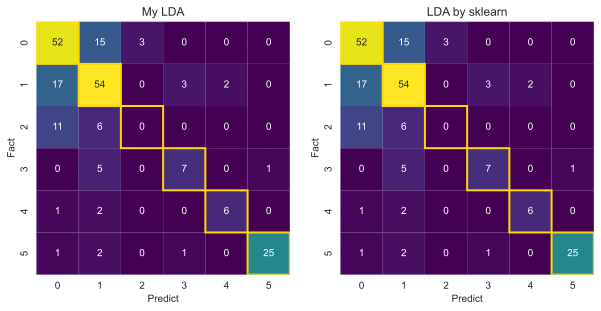

In [20]:
from sklearn.metrics import confusion_matrix
from matplotlib.patches import Rectangle


fig, axes = plt.subplots(1, 2, figsize=(10, 8))

ax = sns.heatmap(confusion_matrix(y, predict), annot=True, cmap='viridis', cbar=False, square=True, ax=axes[0])
axes[0].set_xlabel('Predict')
axes[0].set_ylabel('Fact')
for i in range(6):
  axes[0].add_patch(Rectangle((i, i), 1, 1, fill=False, edgecolor='gold', lw=2))

ax = sns.heatmap(confusion_matrix(y, predict_other), annot=True, cmap='viridis', cbar=False, square=True, ax=axes[1])
axes[1].set_xlabel('Predict')
axes[1].set_ylabel('Fact')
for i in range(6):
  axes[1].add_patch(Rectangle((i, i), 1, 1, fill=False, edgecolor='gold', lw=2))

axes[0].set_title('My LDA')
axes[1].set_title('LDA by sklearn')
fig.show()

## Успех

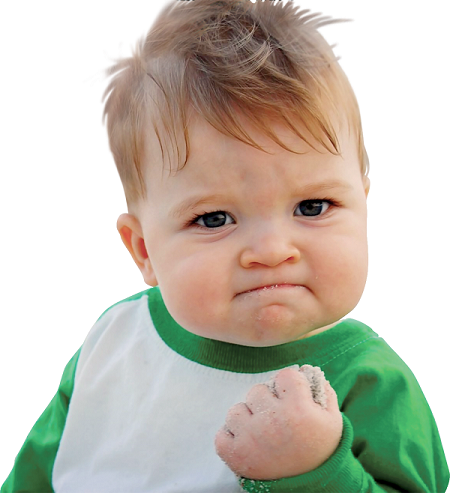

---

**Задание 2.** Use LDA and QDA for dataset admission.csv. You should write your own realisations of the functions for MLE estimations and classification. 
In LDA case Σ you can estimate using the whole dataset.
Visualise your results (colored points and separation lines).

In [24]:
df = pd.read_csv('admission.csv')

df.head(3)

,GPA,GMAT,De
0,2.96,596,admit
1,3.14,473,admit
2,3.22,482,admit


In [27]:
test = pd.DataFrame({"GPA":[2.9, 2.5, 3.4],"GMAT":[400,515,487]})

LDA 

In [44]:
clf = LDA()
X, y = df[['GPA', 'GMAT']], df['De']
              
clf.fit(X,y,['GPA', 'GMAT'])    
predict = pd.Series(clf.predict(X), name='De Predict')

In [29]:
from matplotlib import colors

fig, axes = plt.subplots(1, 2, figsize=(12, 4))

sns.scatterplot(x=X['GPA'], y=X['GMAT'], hue=y, hue_order=['admit', 'border', 'notadmit'], ax=axes[0])
sns.scatterplot(x=X['GPA'], y=X['GMAT'], hue=predict, hue_order=['admit', 'border', 'notadmit'], ax=axes[1])
axes[0].set_title('Fact Values')
axes[1].set_title('Prediction')

def plot_proba_area(clf, ax):
  nx, ny = 100, 100
  x_min, x_max = ax.get_xlim()
  y_min, y_max = ax.get_ylim()
  xx, yy = np.meshgrid(np.linspace(x_min, x_max, nx), np.linspace(y_min, y_max, ny))
  Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])
  for i in range(Z.shape[1]):
    Z_ = Z[:, i].reshape(xx.shape)
    ax.pcolormesh(
        xx, yy, Z_, norm=colors.Normalize(0.0, 1.0), zorder=0, alpha=0.3
    )
    ax.contour(xx, yy, Z_, [0.5], linewidths=2.0, colors="white")

plot_proba_area(clf, axes[0])
plot_proba_area(clf, axes[1])

plt.show()

In [45]:
test['My LDA Predict'] = clf.predict(test)

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 5 is different from 2)

In [31]:
import numpy as np
import pandas as pd
from pandas import DataFrame, Series
from numpy import ndarray

from typing import Union, Optional


def softmax(x):
    """Softmax-функция."""
    e_x = np.exp(x)
    return e_x / e_x.sum(axis=0)


class QDA:
    def __init__(self):
        self.features_ =    None # Названия параметров
        self.classes_ =     None # Названия классов
        self.n_classes_ =   None # Кол-вл классов
        self.priors_ =      None # Частоты классов (априорная вероятность класса)
        self.covariance_ =  None # Матрица ковариации
        self.means_ =       None # Средние параметров по классам
        self.coef_ =        None # Бета
        self.intercept_ =   None # Гамма

    def validate_data(self, X, y=None):
      """//TODO: Преобразование данных в numpy.array"""
      if isinstance(X, DataFrame):
        X = X.values
      if isinstance(y, (DataFrame, Series)):
        y = y.values
      if y is None:
        return X
      else:
        return X, y

    def _get_weighted_covariance(self, X: ndarray, y: ndarray) -> ndarray:
        """
        Получение матриц ковариаций для классов
        
        :param X: Массив наблюдений
        :param y: Массив с метками класса для каждого наблюдения
        :return: Матрица ковариации
        """
        cov = []
        for cls in self.classes_:
            cov += [np.cov(X[y == cls, :].T)]
        return cov

    def _get_class_means(self, X: ndarray, y: ndarray) -> ndarray:
        """
        Cредние по классам
        :param X: Массив наблюдений
        :param y: Массив с метками класса для каждого наблюдения
        :return: Матрица средних значений параметров по каждому классу
        """
        means = []
        for cls in self.classes_:
            means += [np.mean(X[y == cls, :], axis=0)]
        return np.array(means)

    def fit(self, X: ndarray, y: ndarray,
            features: Optional[Union[list, ndarray]] = None):
        """
        :type X: object
        :param y:
        :param features:
        """
        X, y = self.validate_data(X, y)
        self.classes_, counts = np.unique(y, return_counts=True)
        self.priors_ = counts / counts.sum()
        self.n_classes_ = self.classes_.shape[0]
        self.covariance_ = self._get_weighted_covariance(X, y)
        self.means_ = self._get_class_means(X, y)


    def predict(self, X):
        """ Получение предсказаний (меток)"""
        result = []
        idx = np.argmax(self.predict_proba(X), axis=1)
        for id in idx:
          result += [self.classes_[id]]
        return result

    def predict_proba(self, X):
        """ Получение предсказаний (меток)"""
        result = []
        X = self.validate_data(X)
        for x in X:
          probs = []
          for c in range(self.n_classes_):
            zc = -0.5*(x-self.means_[c]).T@np.linalg.inv(self.covariance_[c])@(x-self.means_[c])
            prob_c = (self.priors_[c]/np.linalg.norm(2*np.pi*self.covariance_[c]))*np.exp(zc)
            probs += [prob_c]
          result += [np.array(probs)/np.sum(probs)]
          
        return np.array(result)

In [32]:
clf = QDA()
X, y = df[['GPA', 'GMAT']], df['De']
              
clf.fit(X,y,['GPA', 'GMAT'])    
predict = clf.predict(X)

In [33]:
test['My QDA Predict'] = clf.predict(test[['GPA', 'GMAT']])

In [34]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
clf_ = QuadraticDiscriminantAnalysis(store_covariance=True)
clf_.fit(X, y)

predict_ = clf_.predict(X)
test['Sklearn QDA Predict'] = clf_.predict(test[['GPA', 'GMAT']])

In [35]:
from scipy import linalg
import matplotlib as mpl

def plot_ellipse(splot, mean, cov, color):
    v, w = linalg.eigh(cov)
    u = w[0] / linalg.norm(w[0])
    angle = np.arctan(u[1] / u[0])
    angle = 180 * angle / np.pi  # convert to degrees
    # filled Gaussian at 2 standard deviation
    ell = mpl.patches.Ellipse(
        mean,
        2 * v[0] ** 0.5,
        2 * v[1] ** 0.5,
        angle=180 + angle,
        facecolor=color,
        edgecolor="black",
        linewidth=2,
    )
    ell.set_clip_box(splot.bbox)
    ell.set_alpha(0.2)
    splot.add_artist(ell)
    splot.set_xticks(())
    splot.set_yticks(())


def plot_qda_cov(qda, splot):
    plot_ellipse(splot, qda.means_[0], qda.covariance_[0], "blue")
    plot_ellipse(splot, qda.means_[1], qda.covariance_[1], "orange")
    plot_ellipse(splot, qda.means_[2], qda.covariance_[2], "green")

In [36]:
from matplotlib.patches import Ellipse

fig, axes = plt.subplots(1, 3, figsize=(14, 4))

sns.scatterplot(x=X['GPA'], y=X['GMAT'], hue=y, hue_order=['admit', 'border', 'notadmit'], ax=axes[0])
sns.scatterplot(x=X['GPA'], y=X['GMAT'], hue=predict,hue_order=['admit', 'border', 'notadmit'], ax=axes[1])
sns.scatterplot(x=X['GPA'], y=X['GMAT'], hue=predict_,hue_order=['admit', 'border', 'notadmit'], ax=axes[2])
for mean in clf.means_:
  axes[0].scatter(*mean, color='black')
  axes[1].scatter(*mean, color='black')
for mean in clf_.means_:
  axes[2].scatter(*mean, color='black')


plot_proba_area(clf, axes[0])
plot_proba_area(clf, axes[1])
plot_proba_area(clf_, axes[2])

plot_qda_cov(clf,axes[0])
plot_qda_cov(clf,axes[1])
plot_qda_cov(clf_,axes[2])

axes[0].set_title('Fact Values')
axes[1].set_title('My Prediction')
axes[2].set_title('Sklearn Prediction')
plt.show()

C:\Users\vital\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but QuadraticDiscriminantAnalysis was fitted with feature names
  warnings.warn(


In [37]:
test # Результаты на тестовой выборке

,GPA,GMAT,My LDA Predict,My QDA Predict,Sklearn QDA Predict
0,2.9,400,border,border,border
1,2.5,515,notadmit,notadmit,notadmit
2,3.4,487,admit,admit,admit


### Задание 2. (не готово)

Generate $20$ values for $X$ and $Y$. $X_1 = 0$, $X_{20} = 20$. From $2$ to $19$ $X$ must be generated from $U(0,20)$, $Y \sim U(0,10)$. Using gaussian model interpolate data in interval $[0,20]$. Plot confidence intervals generated from the resulting model. 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%config InlineBackend.figure_formats = ['svg']

plt.rcParams['figure.figsize'] = (12, 4)

Генерируем точки $X$ и $Y$

Text(0, 0.5, 'Y')

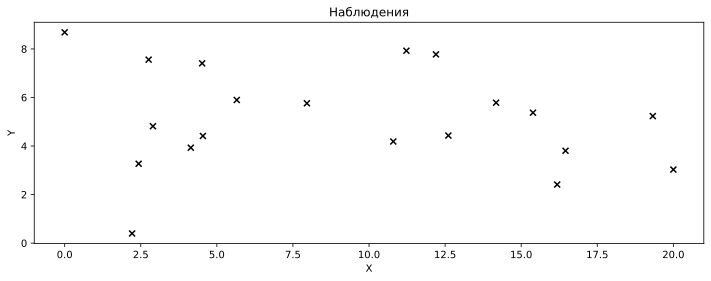

In [ ]:
D = 20

X = np.sort(np.random.uniform(0, 20, D))
Y = np.random.uniform(0, 10, D)
X[0], X[19] = 0, 20

plt.title('Наблюдения')
plt.scatter(X, Y, marker='x', color='black')
plt.xlabel('X')
plt.ylabel('Y')

Мы хотим приблизить одномерную функцию $\mathop{f}$ на интервале $[0, T]$.

In [ ]:
def get_sofdm(D):
  L = np.zeros((D-2, D))
  j = 0
  for i in range(D - 2):
    L[i, j], L[i, j+1], L[i, j+2] = -1, 2, -1
    j+= 1
  return 0.5*L

In [ ]:
x = np.arange(0, 20, 0.1)

In [ ]:
def fit_predict(X, Y, x):
  N = X.shape[0]
  D = x.shape[0] + N
  L = get_sofdm(D)
  L1, L2 = L[:,:D-N], L[:,D-N:]
  mean = np.dot(-L1.T, np.dot(L2,Y))
  sigma = np.linalg.inv(L1.T @ L1)
  return mean, sigma, L, L1, L2


In [ ]:
mean, sigma, L, L1, L2 = fit_predict(X, Y, x)

In [ ]:
sigma

array([[1.07468000e+07, 1.06664000e+07, 1.05860040e+07, ...,
        4.78399999e+03, 2.39600000e+03, 7.99999999e+02],
       [1.06664000e+07, 1.05868000e+07, 1.05072000e+07, ...,
        4.75999999e+03, 2.38400000e+03, 7.95999999e+02],
       [1.05860040e+07, 1.05072000e+07, 1.04283960e+07, ...,
        4.73599999e+03, 2.37200000e+03, 7.91999999e+02],
       ...,
       [4.78399999e+03, 4.75999999e+03, 4.73599999e+03, ...,
        5.60000000e+01, 3.20000000e+01, 1.20000000e+01],
       [2.39600000e+03, 2.38400000e+03, 2.37200000e+03, ...,
        3.20000000e+01, 2.00000000e+01, 8.00000000e+00],
       [7.99999999e+02, 7.95999999e+02, 7.91999999e+02, ...,
        1.20000000e+01, 8.00000000e+00, 4.00000000e+00]])

In [ ]:
Y = np.ones(20)

In [ ]:
sns.heatmap(sigma, cbar=False)

<Axes: >

In [ ]:
mean

array([ 0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,  0.  ,
        0.  ,  0.  ,

(-5.0, 15.0)

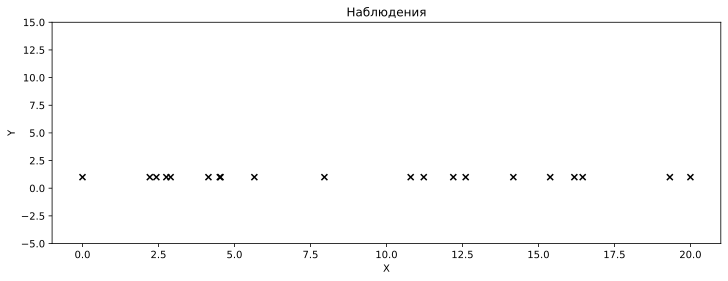

In [ ]:
plt.title('Наблюдения')
plt.scatter(X, Y, marker='x', color='black')
plt.scatter(x, sigma@x, marker='x', color='red')
plt.xlabel('X')
plt.ylabel('Y')
plt.ylim(-5, 15)

<Axes: >

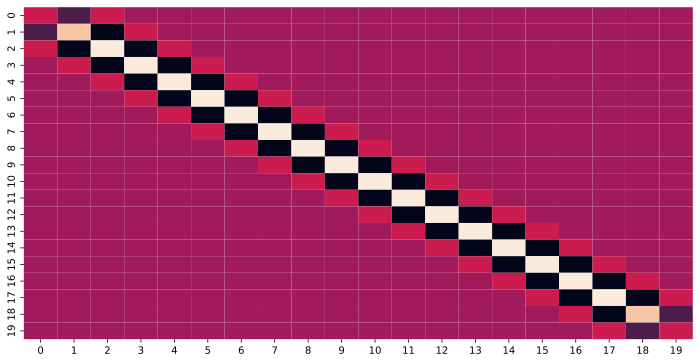

In [ ]:
sns.heatmap(np.matmul(get_sofdm(D).T,get_sofdm(D)), cbar=False)